# Setup

## Imports

In [1]:
import vaidata
import vaikeras

from vaiutils import path_consts, smooth_plot, plot_images
from vaikaggle import dataset_consts, plot_prediction_density
from vaikeras import get_batches
from vaimodels import VGG16
from vaivision import dream

Using TensorFlow backend.


In [2]:
from tqdm import tqdm_notebook

All the Keras modules

In [3]:
import keras.backend as K

from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential, Model
from keras.layers import Dense, Flatten, BatchNormalization, Conv2D, GlobalAvgPool2D, Activation, Dropout

## Define useful variables and functions

In [4]:
for k, v in path_consts('StateFarm'):
    exec(k + '=v')
for k, v in dataset_consts(DIR_DATA, use_sample=False):
    exec(k + '=v')

In [5]:
def pickle_load(filename, default=None, path=DIR_CHECKPOINTS):
    return vaidata.pickle_load(path + '/' + filename + '.p', default)

In [6]:
def pickle_dump(filename, obj, path=DIR_CHECKPOINTS):
    vaidata.pickle_dump(path + '/' + filename + '.p', obj)

In [7]:
def inflate_model(name):
    return vaikeras.inflate_model(DIR_CHECKPOINTS + '/' + name + '.h5', name,
                                  DIR_CHECKPOINTS + '/' + name + '-history.p')

In [8]:
def plot_history():
    smooth_plot(model.training_history, remove_outlier=False, keys=['acc', 'val_acc'])
    plt.show()
    smooth_plot(model.training_history, remove_outlier=False, keys=['loss', 'val_loss'])
    plt.show()

In [9]:
def fit_model(epochs=1, lr=None, save=False):
    save_path = DIR_CHECKPOINTS if save else ''
    vaikeras.fit_model(model, train_batches, epochs,
                       lr, valid_batches, save_path)
    plot_history()

## Get data

In [10]:
generator = ImageDataGenerator()
generator_augmented = ImageDataGenerator(rotation_range=15, width_shift_range=0.1,
                                         height_shift_range=0.05, shear_range=0.1,
                                         channel_shift_range=20)

In [11]:
train_batches = get_batches(DIR_TRAIN, generator_augmented, 64)
valid_batches = get_batches(DIR_VALID, generator, 64, False)

Found 19061 images belonging to 10 classes.
Found 3363 images belonging to 10 classes.


# Explore VGG

In [12]:
vgg = VGG16(input_shape=(224, 224, 3))
vgg.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
preprocess (Lambda)          (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
__________

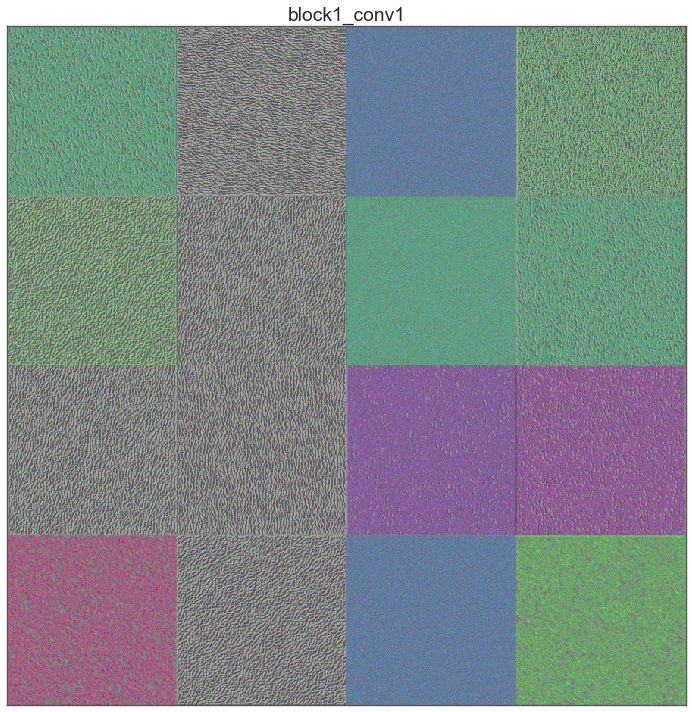

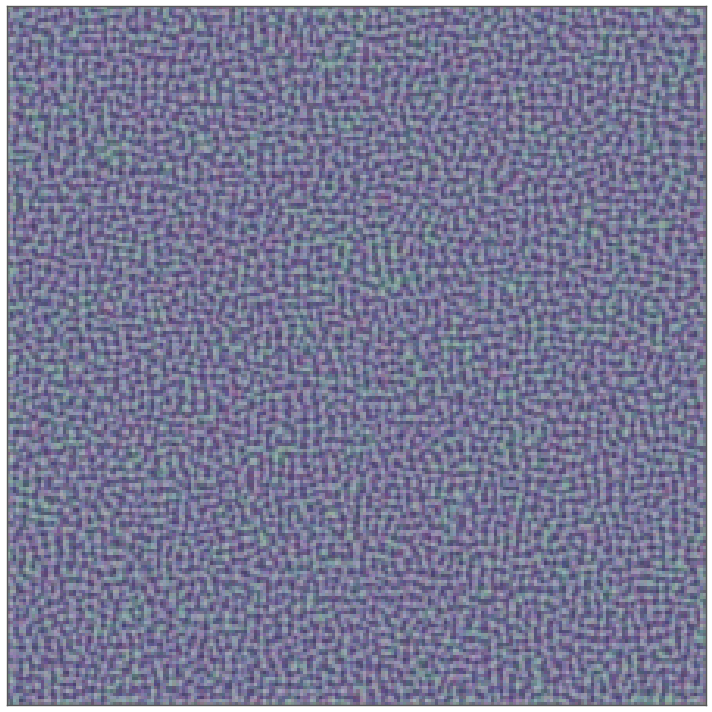

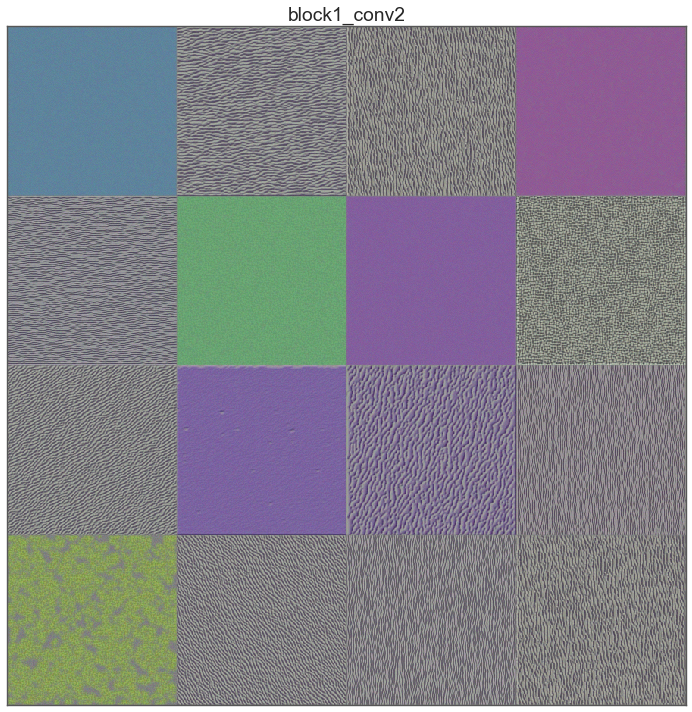

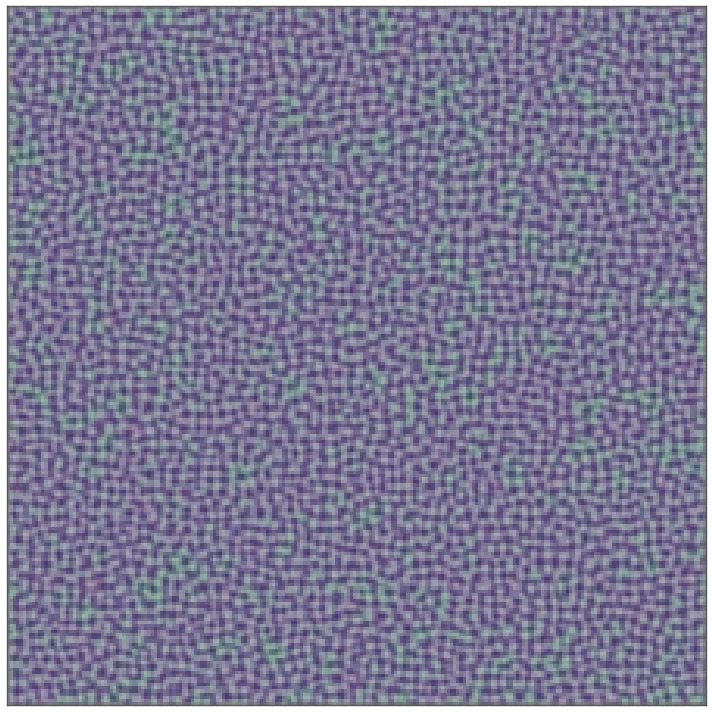

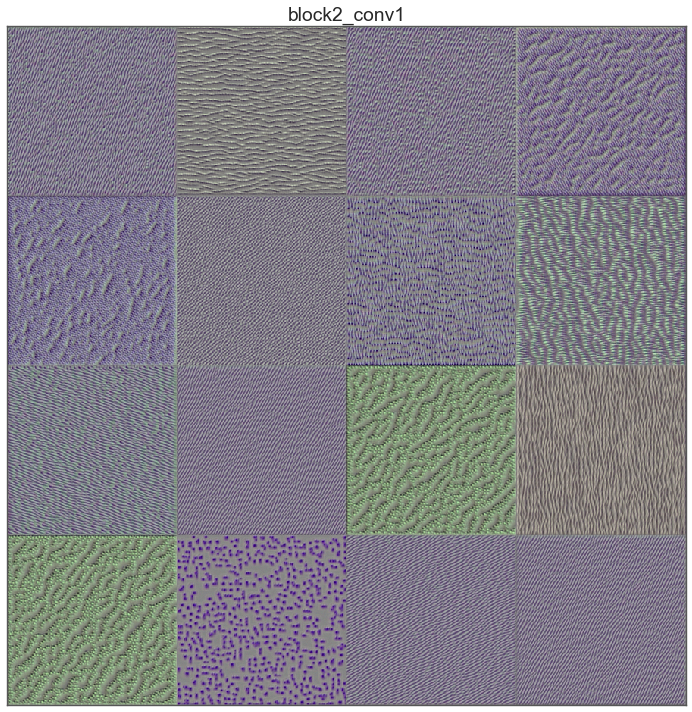

...

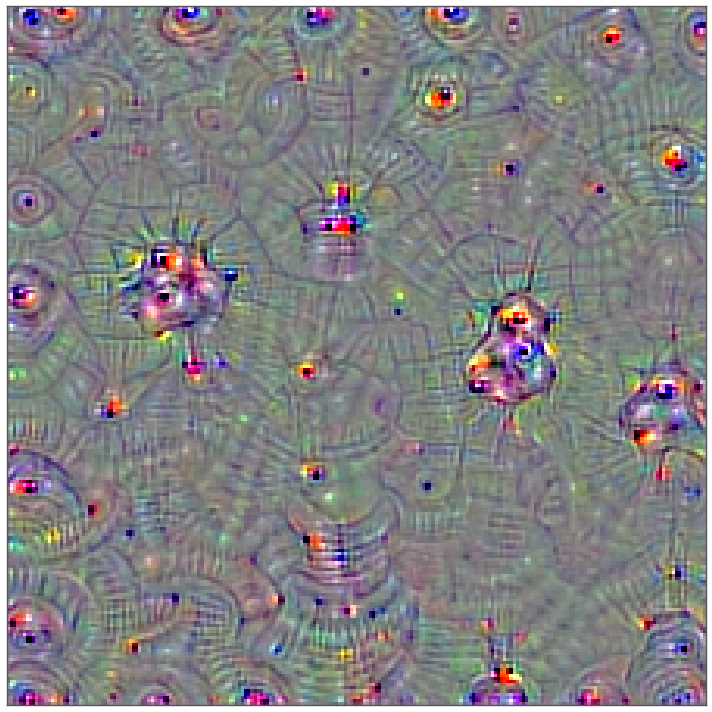

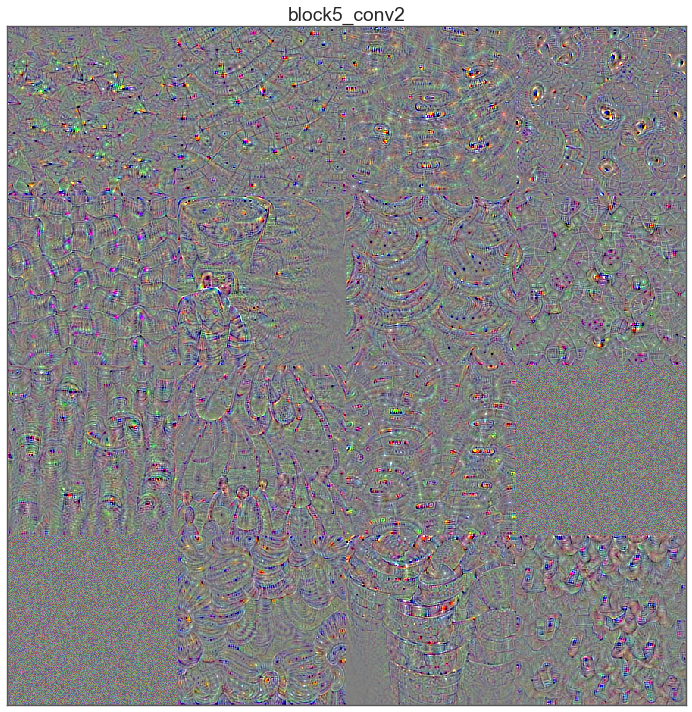

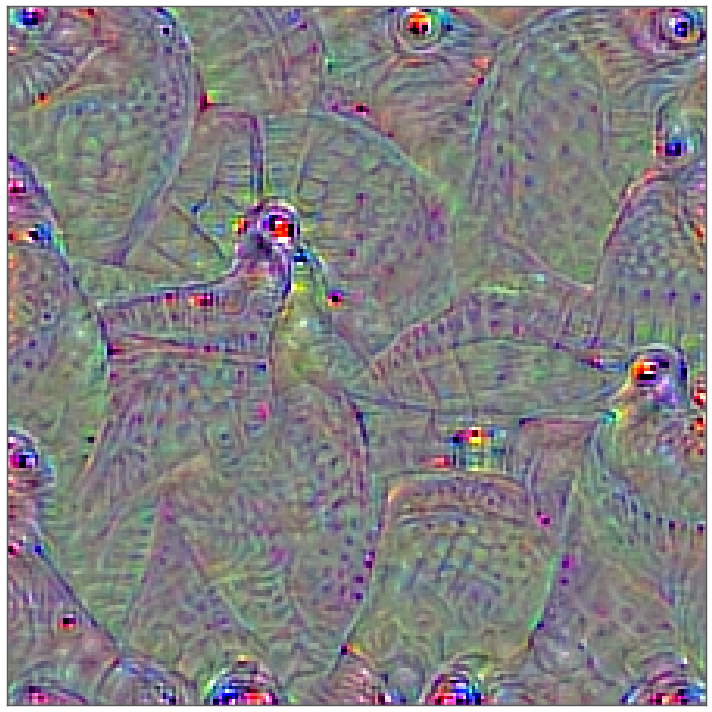

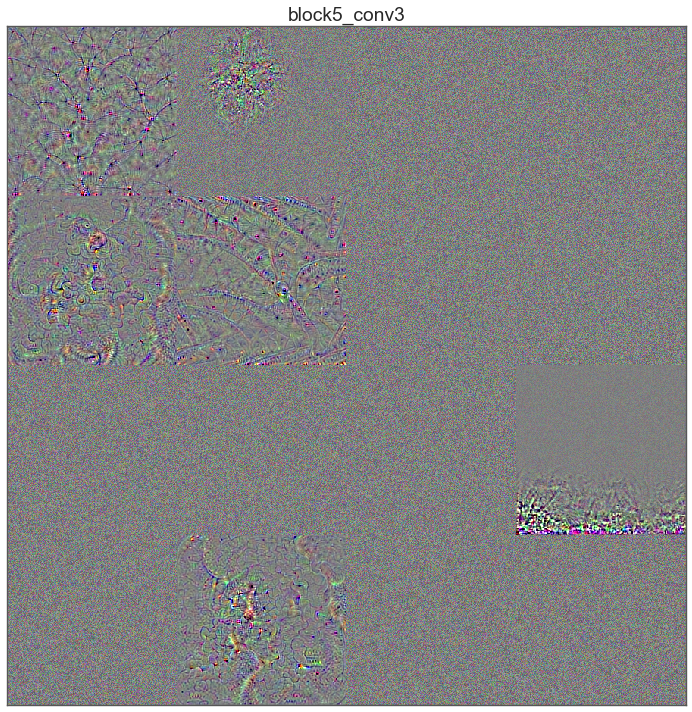

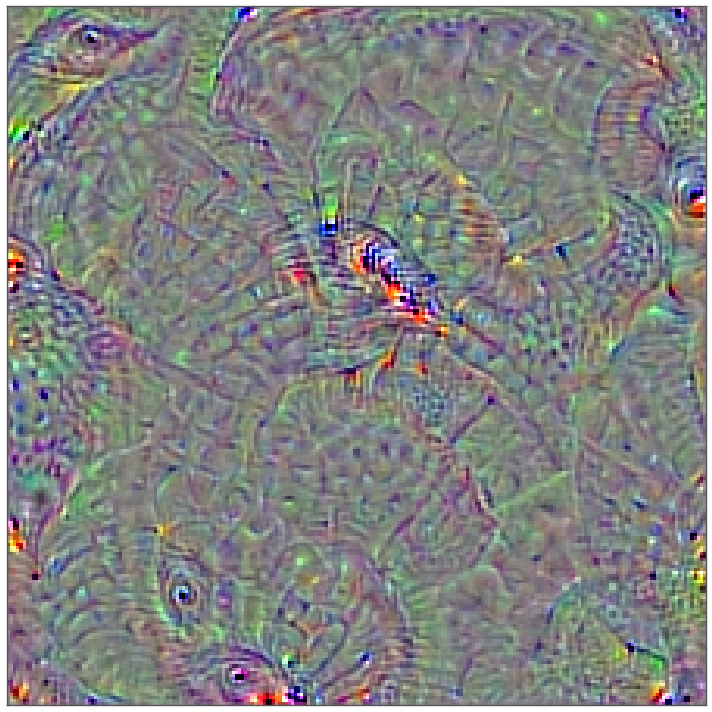

In [18]:
for i, layer in enumerate(tqdm_notebook(vgg.layers)):
    if type(layer) is Conv2D:
        plot_images([dream(vgg, filter_idx=(i, j), strength=i) for j in randint(0, layer.output_shape[-1], 16)], layer.name)
        plot_images([dream(vgg, filter_idx=(i, -1), strength=i)])

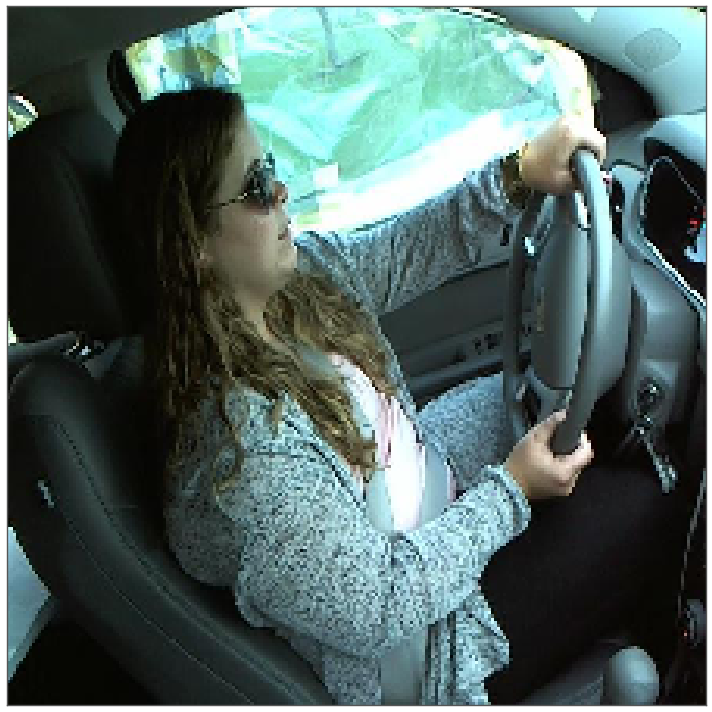

In [20]:
sample_image = valid_batches.next()[0][0]
plot_images([sample_image])

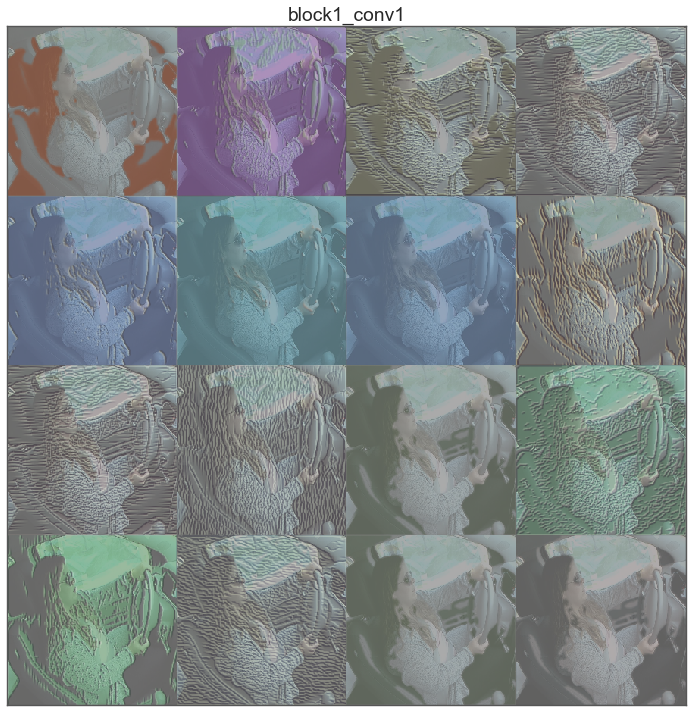

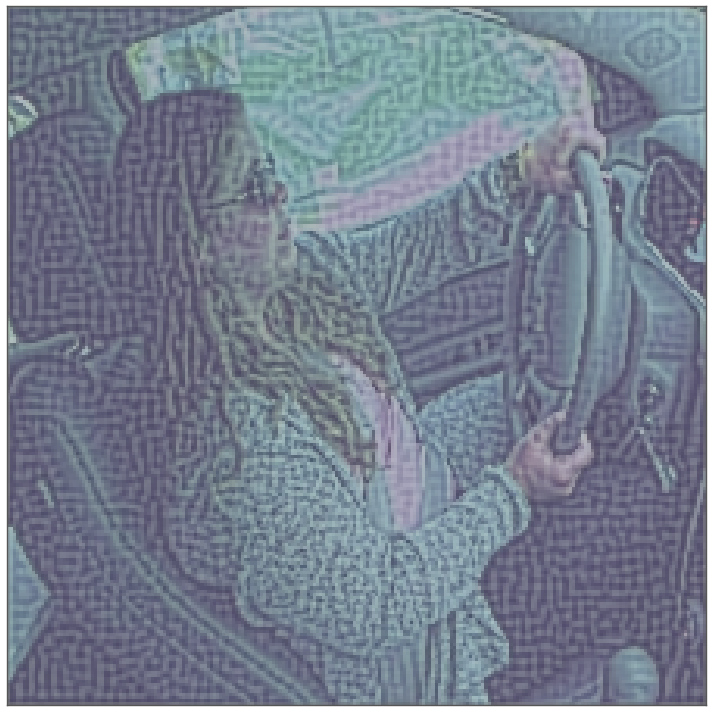

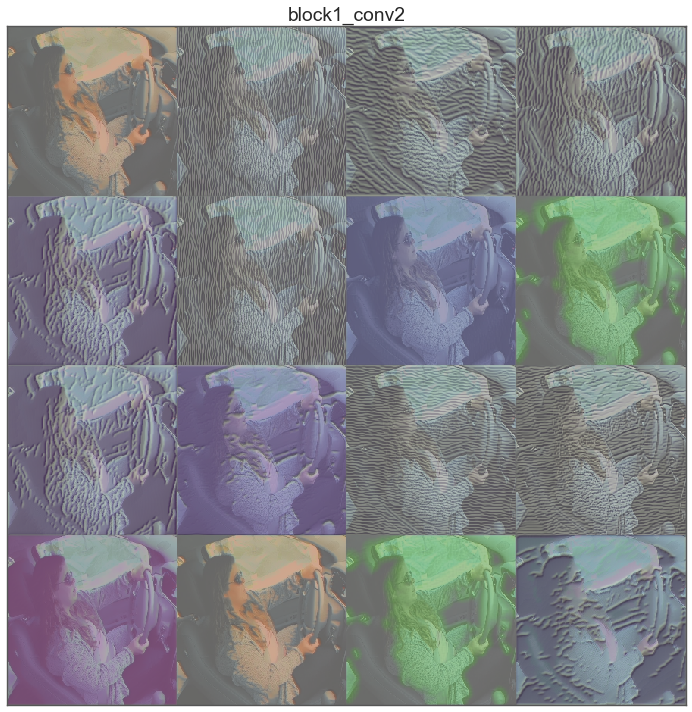

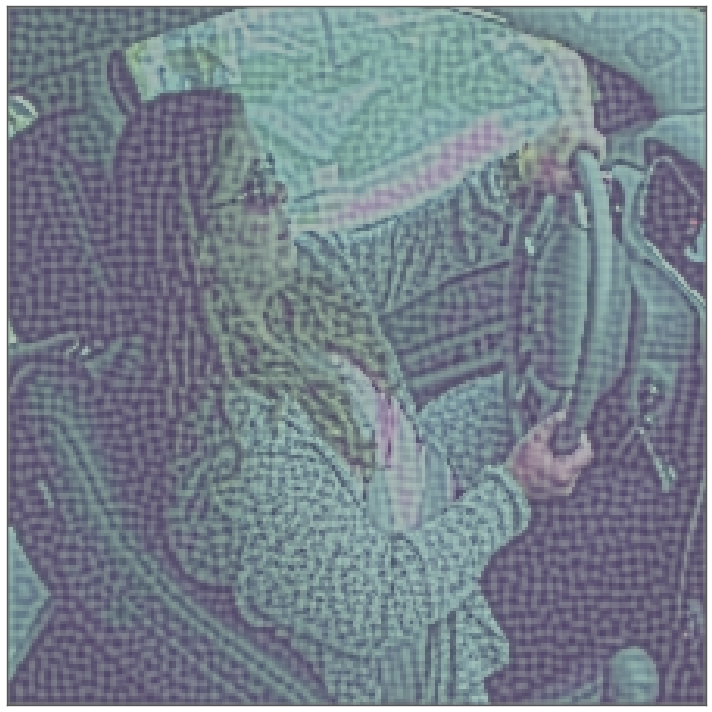

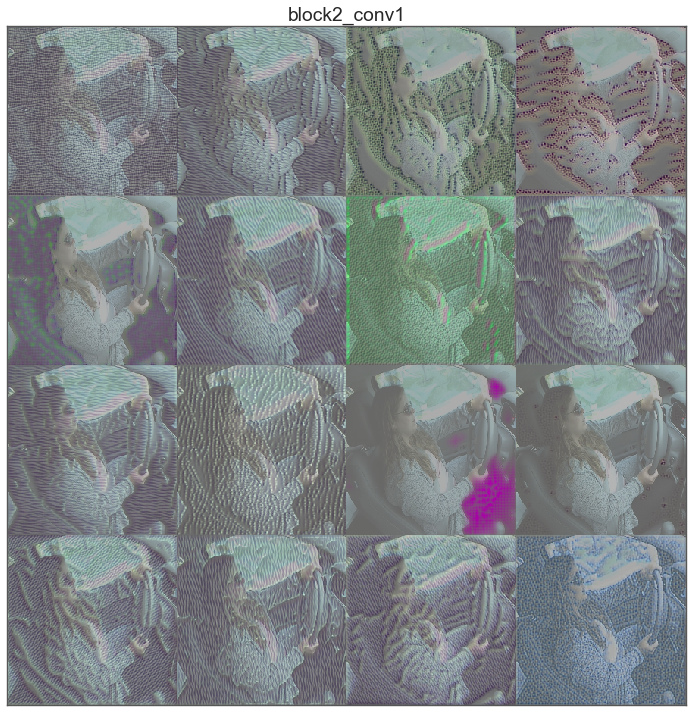

...

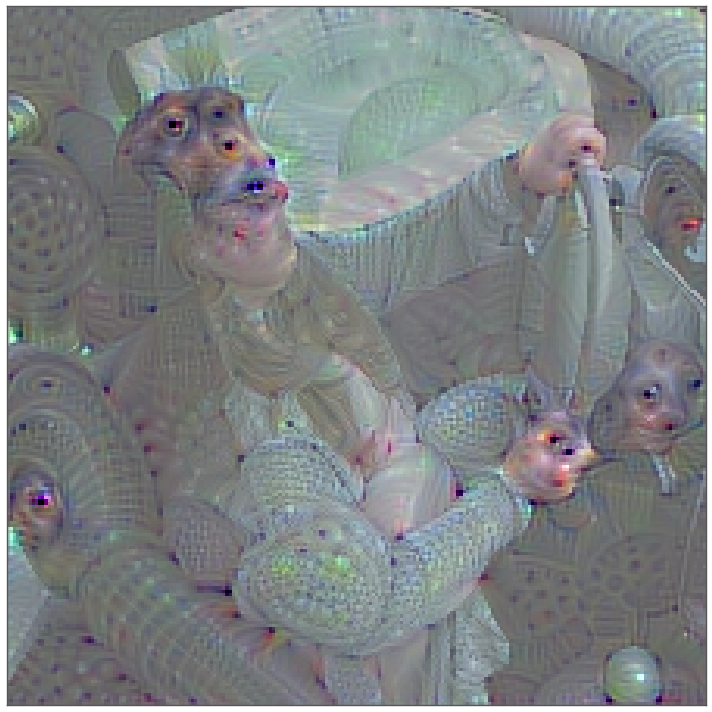

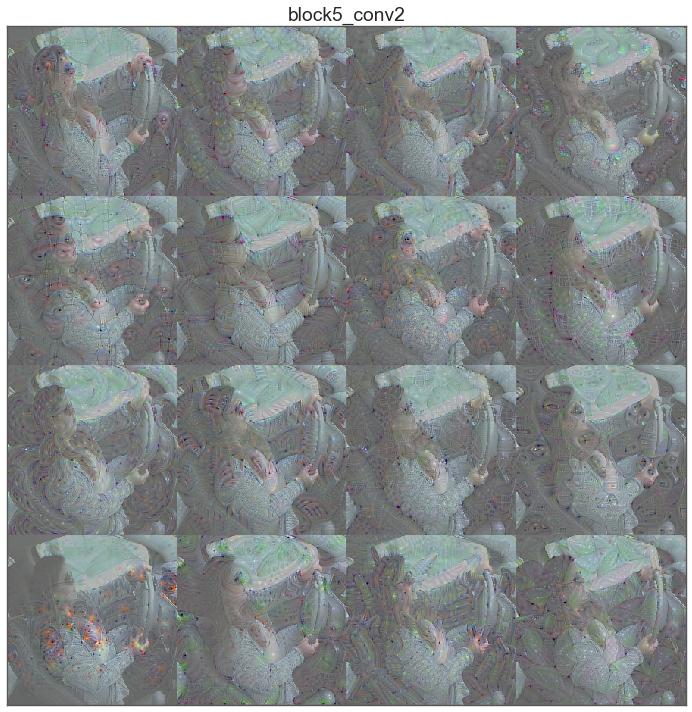

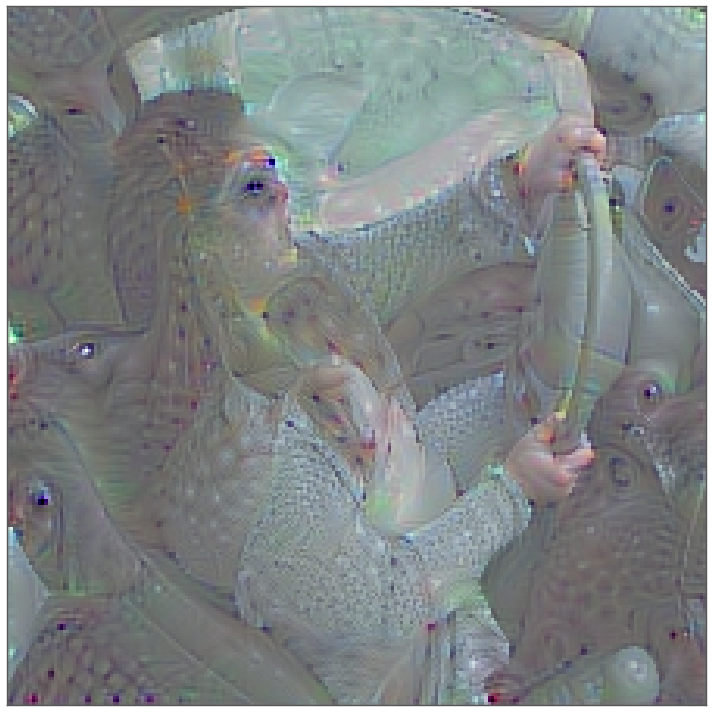

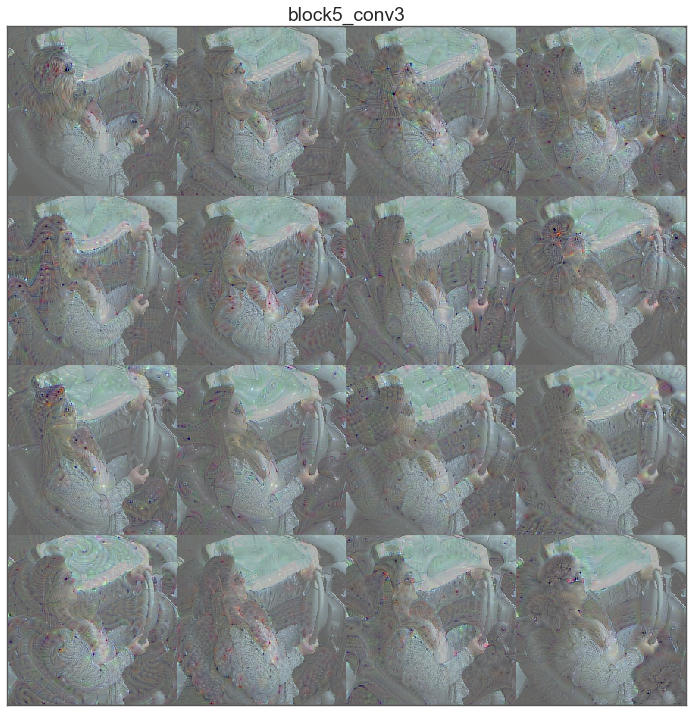

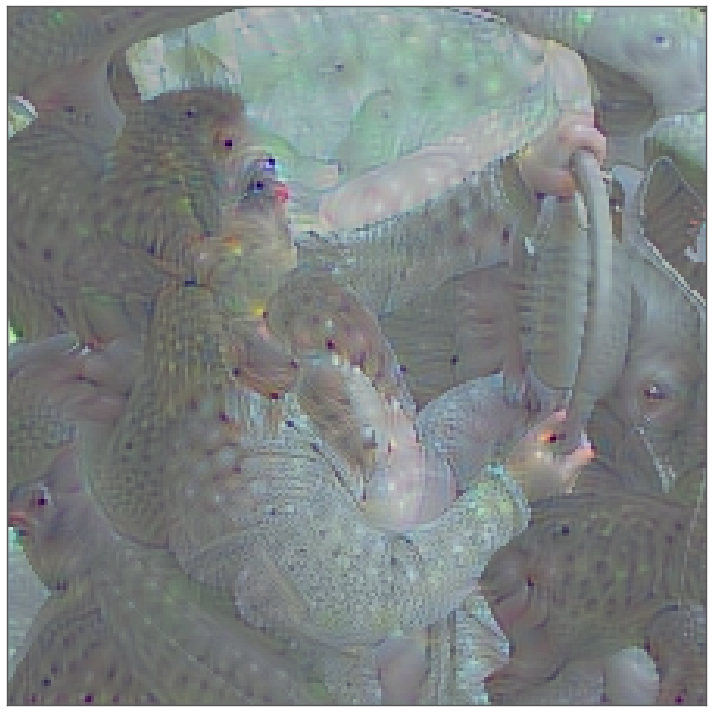

In [23]:
for i, layer in enumerate(tqdm_notebook(vgg.layers)):
    if type(layer) is Conv2D:
        plot_images([dream(vgg, sample_image, filter_idx=(i, j)) for j in randint(0, layer.output_shape[-1], 16)], layer.name)
        plot_images([dream(vgg, sample_image, filter_idx=(i, -1))])

We can go up till block4_conv2.

# BasicVGG

In [12]:
def get_model(dropout=0):
    K.clear_session()
    
    vgg = VGG16(input_shape=(224, 224, 3))
    for layer in vgg.layers:
        layer.trainable = False

    x = vgg.output
    x = BatchNormalization()(x)
    x = Dropout(dropout)(x)
    x = Conv2D(10, (7, 7), strides=(1, 1),
            padding='valid', activation='softmax')(x)
    x = Flatten()(x)
    
    model = Model(vgg.input, x)

    model.name = 'BasicVGG'
    model.training_history = {}
    model.compile('adam', 'categorical_crossentropy', ['accuracy'])
    return model


model = get_model()
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
preprocess (Lambda)          (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
__________

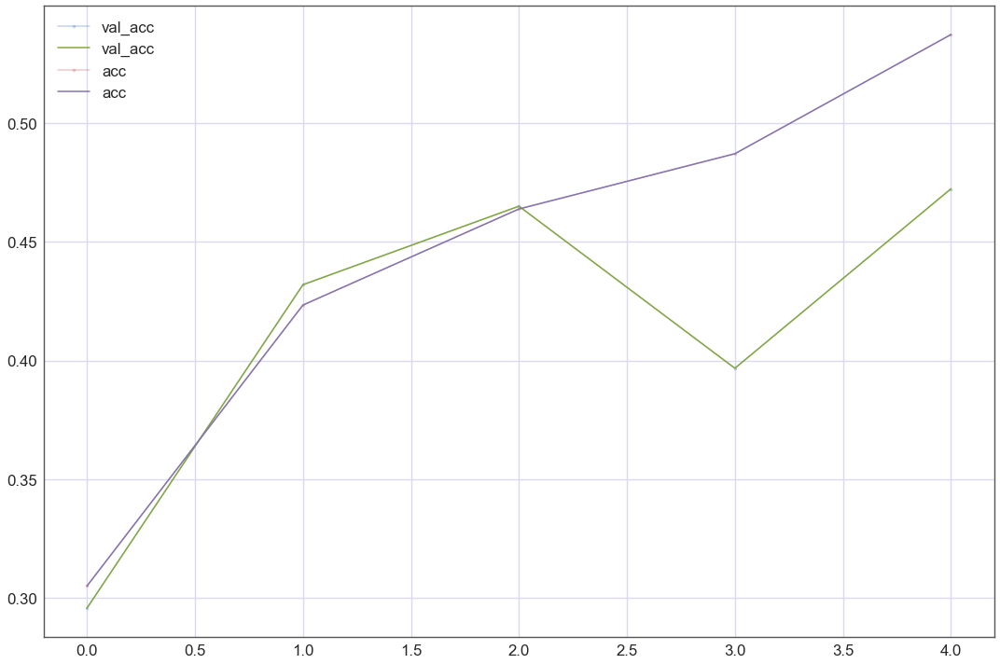

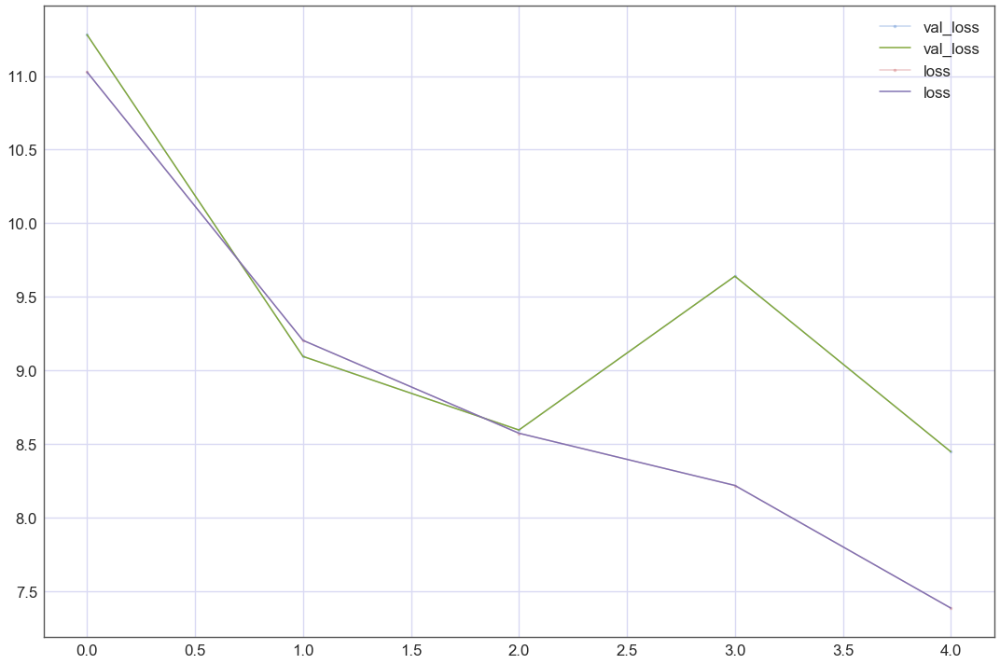

In [18]:
fit_model(5, 1e-3, save=True)

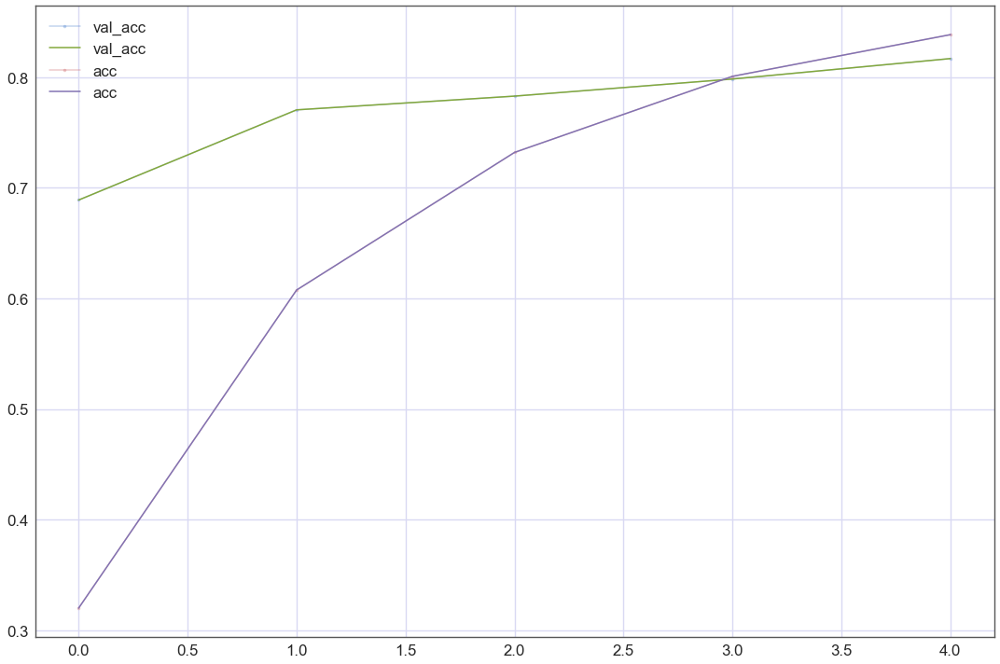

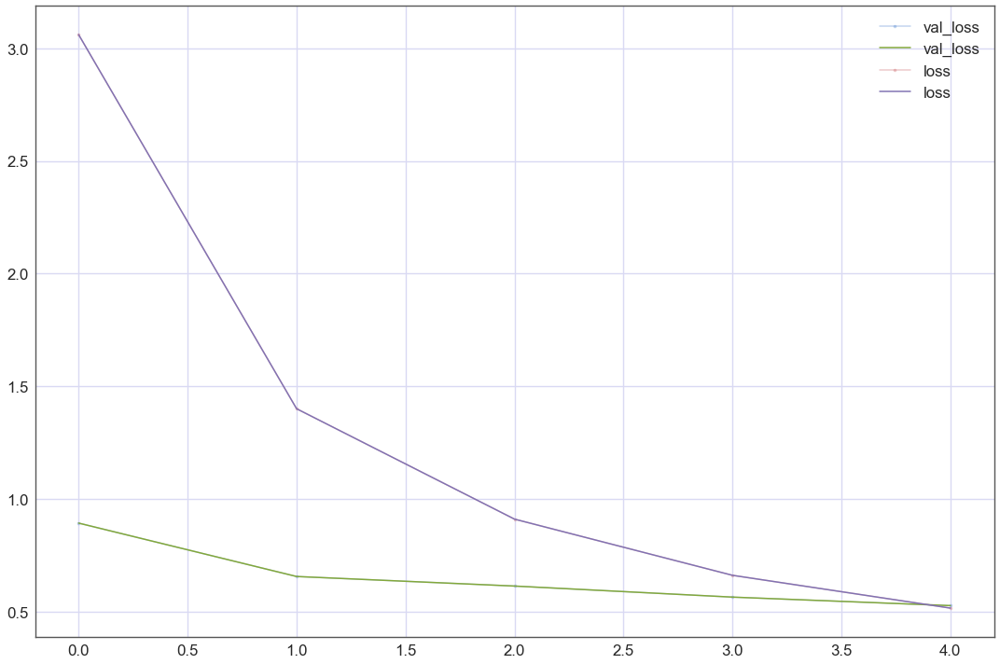

In [13]:
model = get_model(0.8)
fit_model(5, 1e-4, save=True)

In [22]:
model.evaluate_generator(valid_batches, valid_batches.num_batches)

[3.0309006837542469, 0.76993028212041703]

# MidVGG

In [1]:
def get_model(dropout=0):
    K.clear_session()
    
    vgg = VGG16(input_shape=(224, 224, 3))
    for layer in vgg.layers:
        layer.trainable = False

    x = vgg.get_layer('block4_pool').output
    x = BatchNormalization()(x)
    x = Dropout(dropout)(x)
    x = Conv2D(512, (5, 5), padding='same', activation='relu')(x)
    x = Dropout(dropout)(x)
    x = Conv2D(512, (5, 5), padding='same', activation='relu')(x)
    x = Dropout(dropout)(x)
    x = Conv2D(512, (5, 5), strides=(2, 2), padding='same', activation='relu')(x)
    x = Dropout(dropout * 2)(x)
    x = Conv2D(10, (7, 7), padding='valid', activation='softmax')(x)
    x = Flatten()(x)
    
    model = Model(vgg.input, x)

    model.name = 'MidVGG'
    model.training_history = {}
    model.compile('adam', 'categorical_crossentropy', ['accuracy'])
    return model


model = get_model()
model.summary()

NameError: name 'K' is not defined

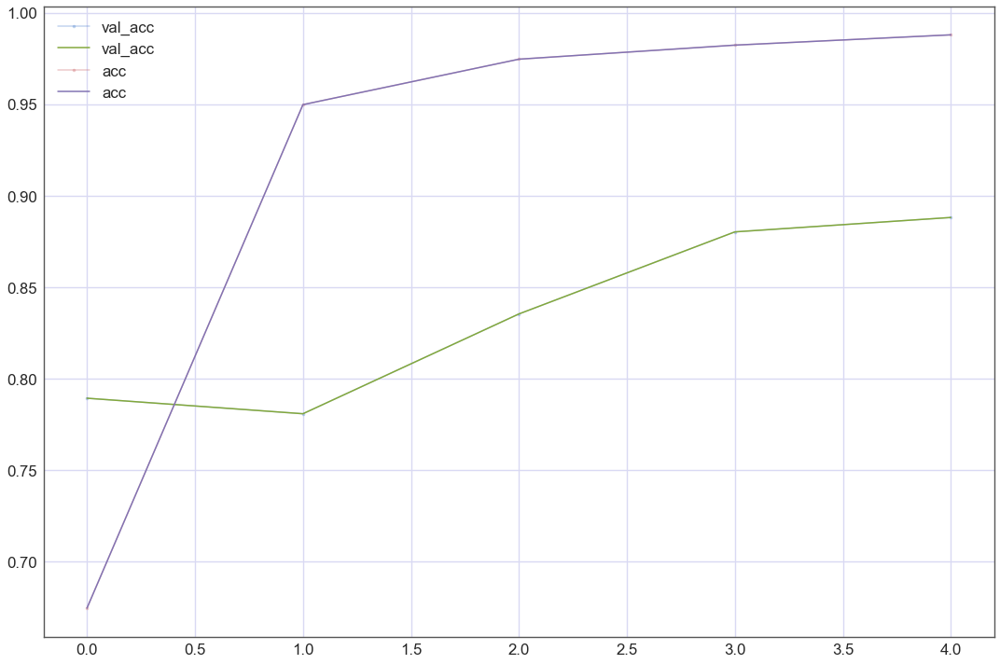

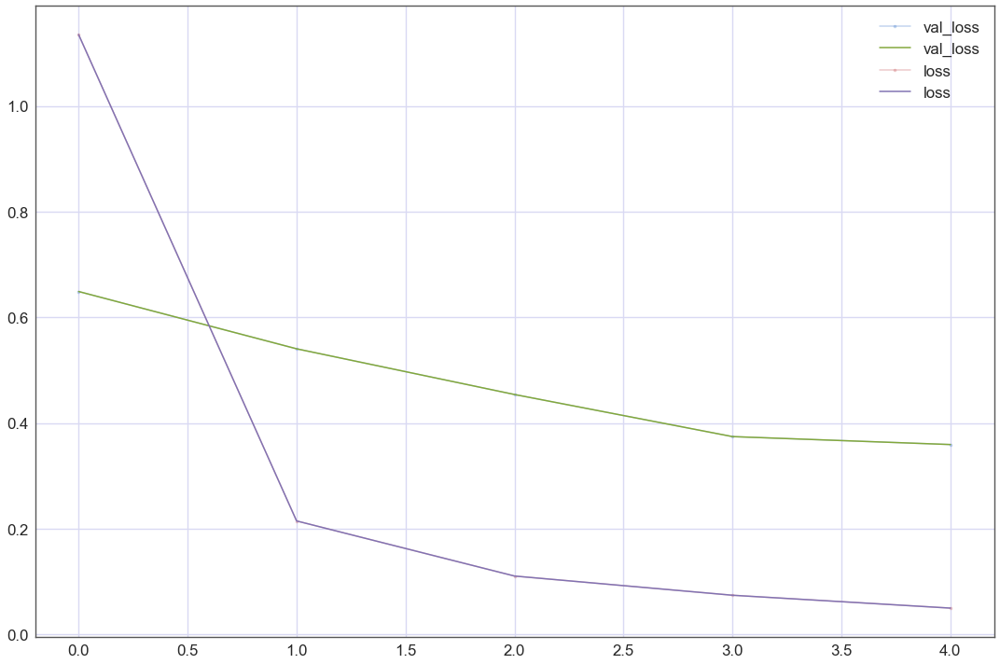

In [20]:
fit_model(5, 1e-5, save=True)

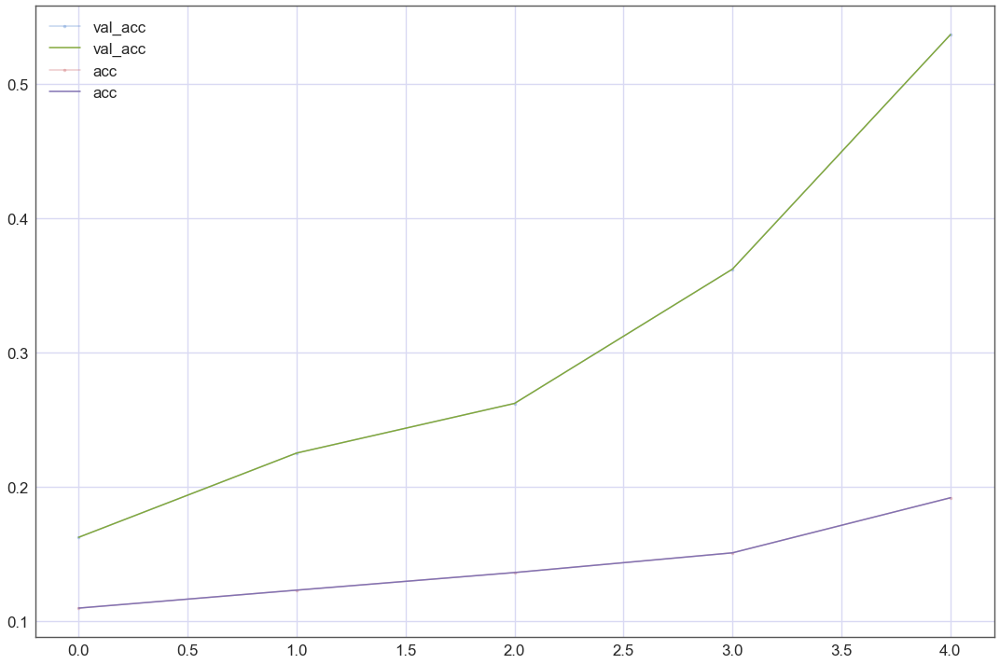

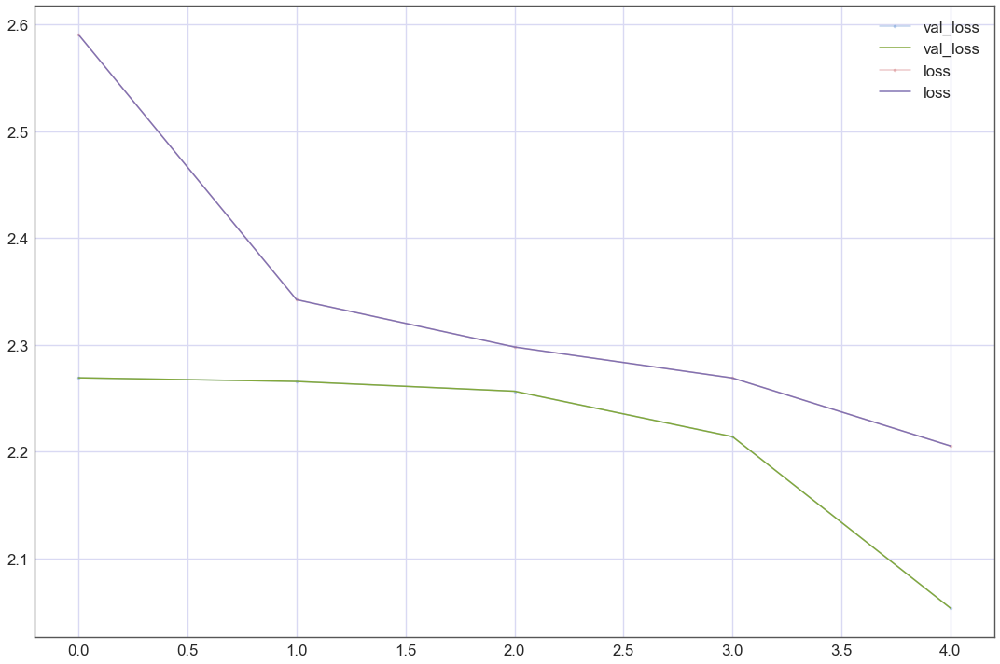

In [22]:
model = get_model(0.4)
fit_model(5, 1e-5, save=True)

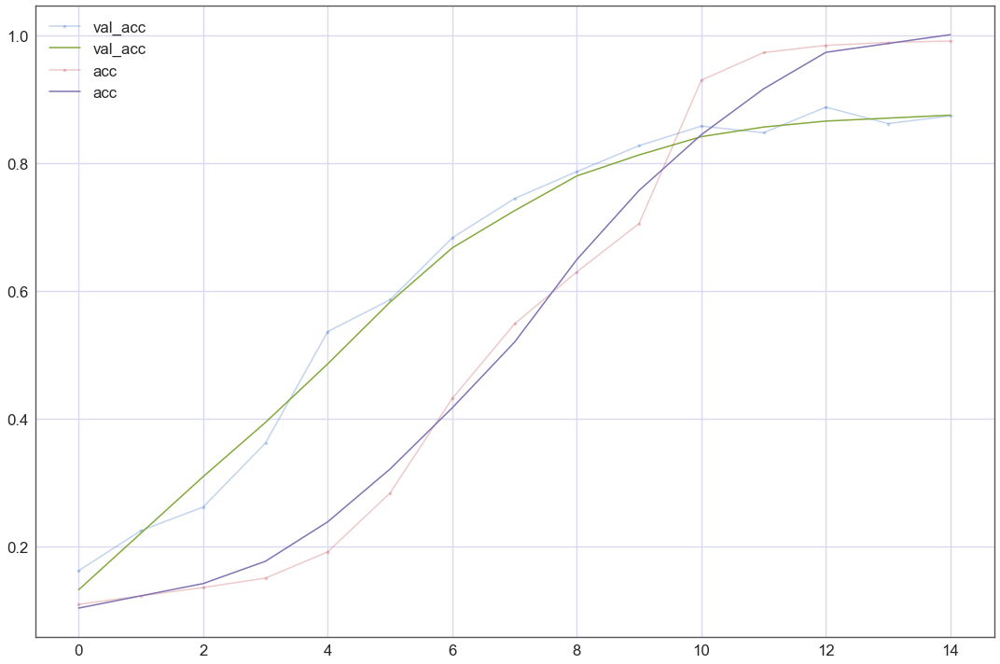

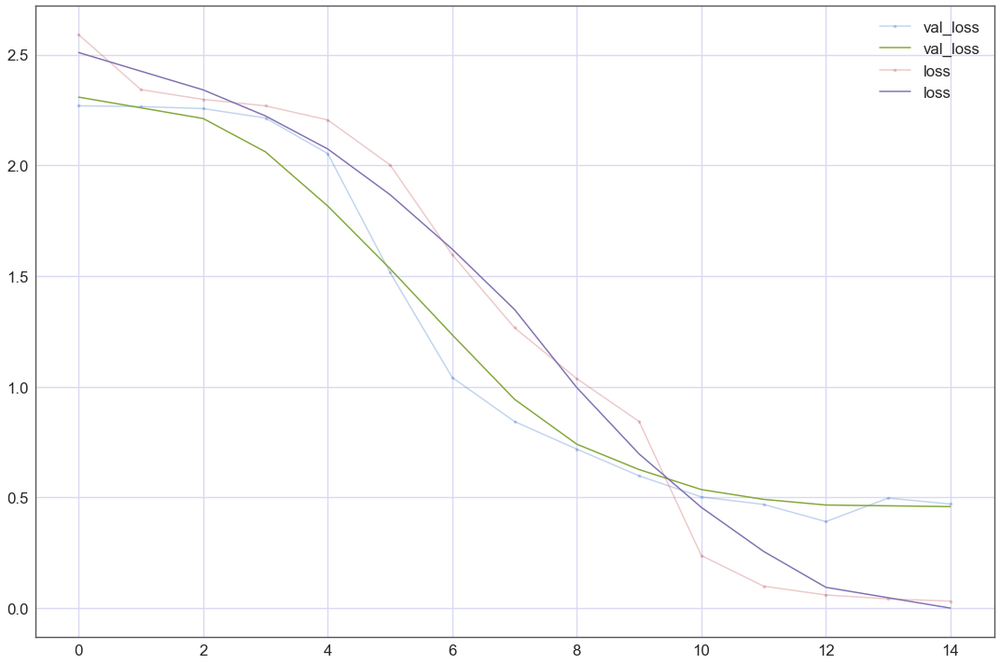

In [19]:
fit_model(5, 1e-5, save=True)

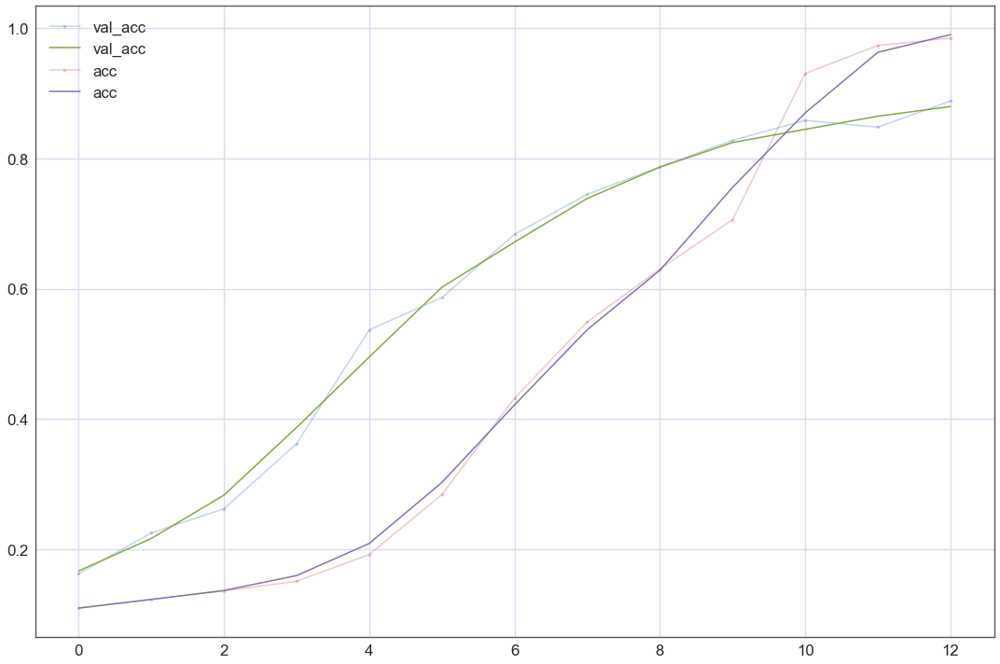

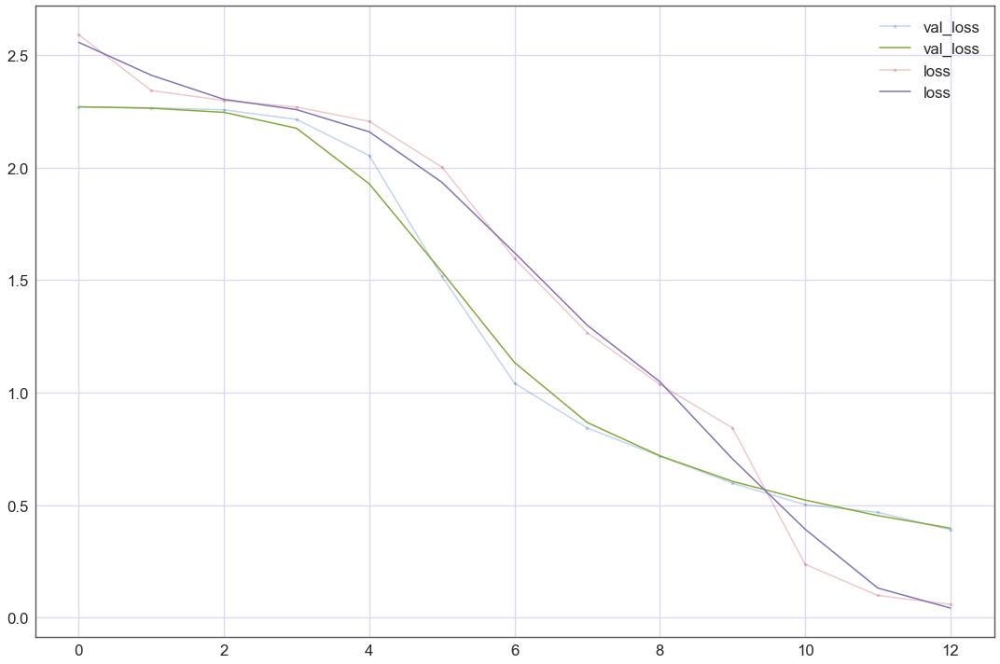

In [21]:
model.load_weights(DIR_CHECKPOINTS+'/'+model.name+'.h5')
model.training_history = pickle_load(model.name + '-history')
plot_history()

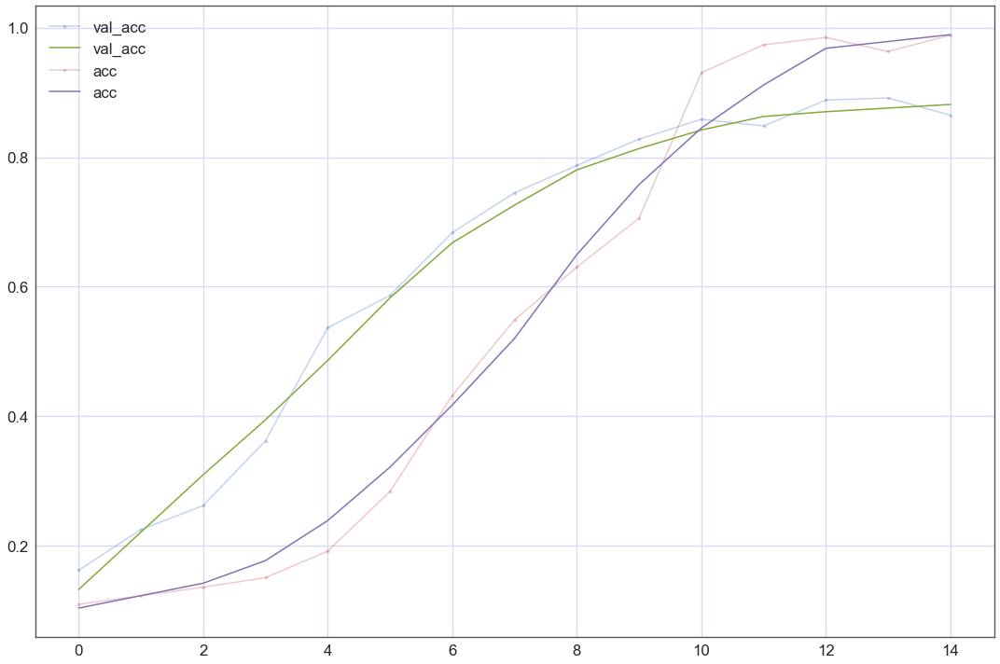

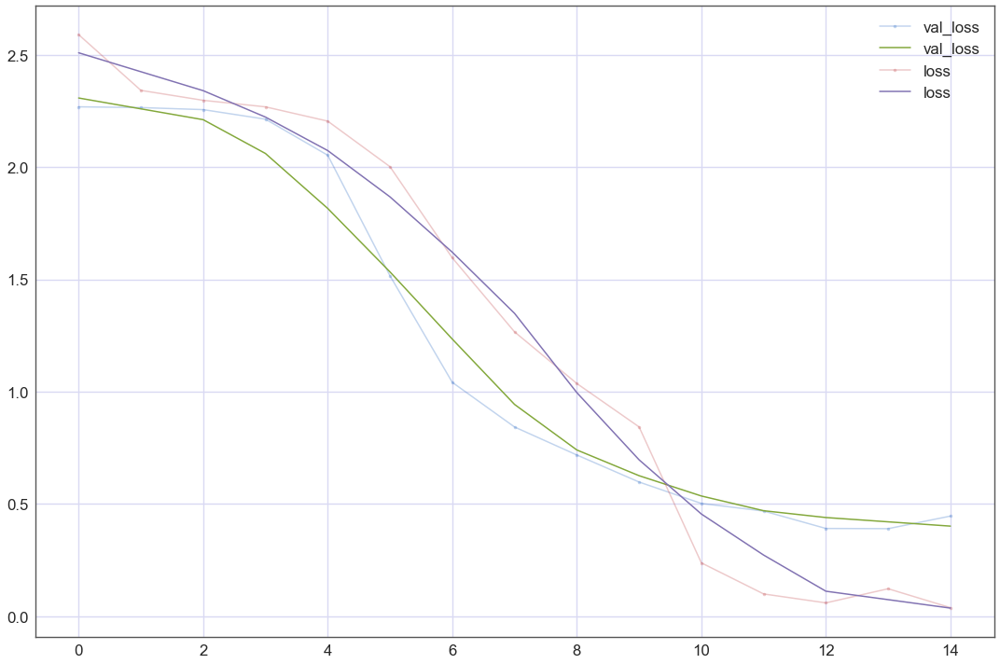

In [22]:
fit_model(2, 1e-4, save=True)